# Wifi Localization Problem Part1

## Table of Contents:
* [0. Problem Description](#Dataset)
* [1. Exploratory Data Analysis (EDA)](#EDA)
  * [1.1. RSSI Levels](#RSSI)
  * [1.2. Longitude and Latitude](#LongLat)
  * [1.3. BuildingID](#BuildingID)
  * [1.4. SpaceID](#SpaceID)
  * [1.5. PhoneID](#SpaceID)
  * [1.6. Timestamp](#Timestamp)

In [1]:
#Load and import workspace
import dill
#dill.dump_session('notebook_session.db')
#dill.load_session('notebook_session.db')

In [2]:
# Import Libraries
import pandas as pd
from pandas import DataFrame
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import math
import scipy

#Import Models
import random
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVR
from sklearn import linear_model

#Model Metrics
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

#Cross Validation
from sklearn.model_selection import train_test_split
from math import sqrt

# <a class="anchor" id="Dataset"> 0. Problem Description </a>  

Localization techniques have been solved with GPS for outdoor positions. However, indoor localization remains a problem. <br> Wifi signals are analyzed in the following study to try to overcome this barrier with the least error possible.

Two datasets have been provided: <br>
1) A training set where 18 different users have been told to stand on an X marked on the floor (with coordinates known) and recorded their RSSI levels. <br>
2) A validation set taken 4 months later, where users chose random places and recorded their RSSI levels and location, but then edited their location when wrong.

In [76]:
#Import Datasets
#### Ignacio: Fixed the correct path of the data files
wifi = pd.read_csv("../Datasets/trainingData.csv") #the '.' is where you have the jupyter file
wifi_val = pd.read_csv("../Datasets/validationData.csv")
#wifi = pd.read_csv("./trainingData.csv") #the '.' is where you have the jupyter file
#wifi_val = pd.read_csv("./validationData.csv")

In [77]:
####Atribute Analysis
display(wifi.info())
#wifi.describe
    #0  -519 WAPs
    #520-522 Coordinates (Long, Lat, Floor)
    #523     BuildingID (0, 1 or 2)
    #524     SpaceID
    #525     Relative position with respect to SpaceID
    #526     UserID
    #527     PhoneID
    #528     Timestamp

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19937 entries, 0 to 19936
Columns: 529 entries, WAP001 to TIMESTAMP
dtypes: float64(2), int64(527)
memory usage: 80.5 MB


None

# <a class="anchor" id="EDA"> 1. Exploratory Data Analysis </a>

In [78]:
#Quick NA Check (No NAs!)
wifi.isna().sum().sum() 
wifi_val.isna().sum().sum()
#The extra .sum() gives you a single total number, otherwise you get the list

0

## <a class="anchor" id="RSSI"> 1.1. RSSI Levels </a>

### Train set

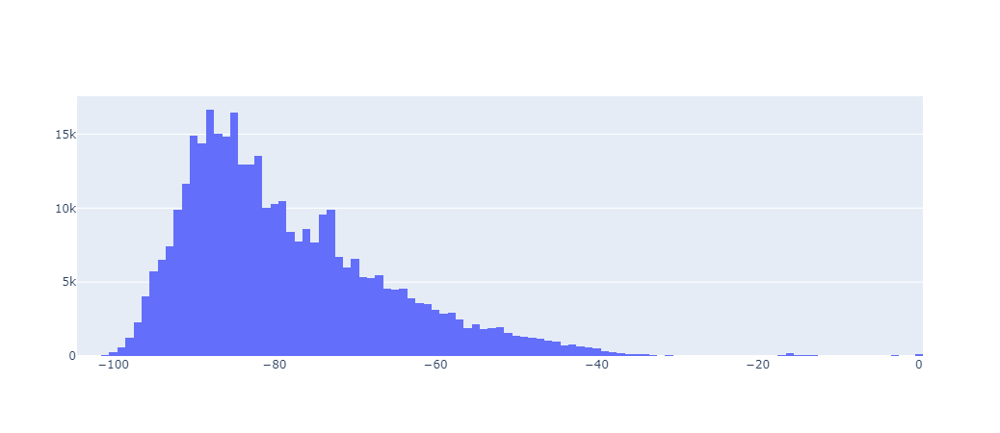

In [79]:
#### Ignacio: This line is needed in order to prevent matplotlib to open the charts in a new window.
%matplotlib inline
#Creating a df with WAP columns only
WAPs = wifi.filter(like="WAP")
WAPsmelted = pd.melt(WAPs)

#plt.hist(WAPsmelted['value'])
#but with the above we see only 100s, since that's the most common
#### Ignacio: EXCELLENT!
WAPSmeltedw0 = WAPsmelted.loc[(WAPsmelted.iloc[:,1] != 100)]
#plt.hist(WAPSmeltedw0['value'], bins =105)
#plt.show()
#Note: 'adding a semicolon at the end of a line (;) will not print that line'
#### Ignacio: The way to prevent matplotlib to print the histogram is using the command
#### ptl.show()
#### You can get better figures using Plotly.
fig = go.Figure(data=[go.Histogram(x=WAPSmeltedw0['value'])])
fig.show()

In [80]:
#Find out which WAPs are not detected
#Example for any one row (returns 100 if WAP is not detected at all in all observations)
#print(sum(wifi.iloc[:,3]/19937)) #Super weird: this should return a 100
#print((sum(wifi.iloc[:,3])/19937)) #Adding another parenthesis...works
#### Ignacio: A more efficient way that you can guess from apply ;) will give you the WAP numbers which had null signal allways
np.add(np.where(wifi.iloc[:,:520].apply(np.mean) == 100),1)[0]

array([  3,   4,  92,  93,  94,  95, 152, 158, 159, 160, 215, 217, 226,
       227, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 254, 293,
       296, 301, 303, 304, 307, 333, 349, 353, 360, 365, 416, 419, 423,
       429, 433, 438, 441, 442, 444, 445, 451, 458, 482, 485, 487, 488,
       491, 497, 520], dtype=int64)

variable    WAP519
value          105
dtype: object


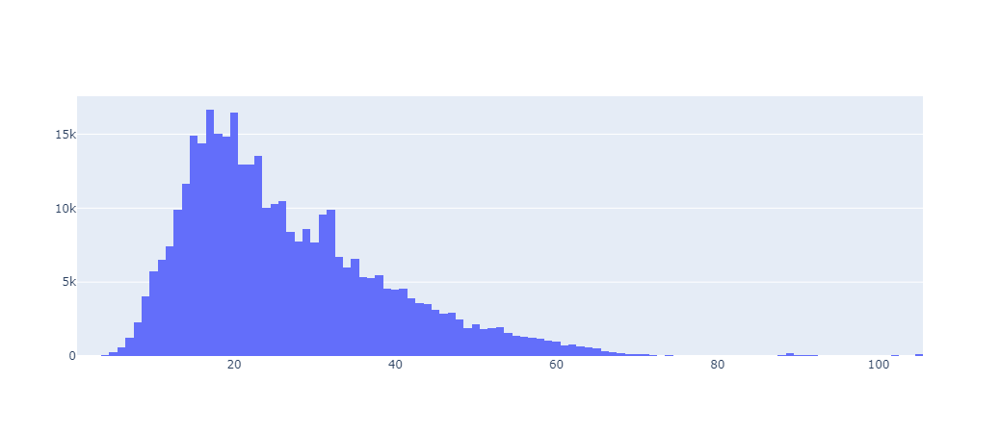

In [81]:
#Change scale of WAPs
#### Ignacio: Why do you want to do this transformation? It should be explained
wifi.iloc[:, 0:520] = np.where(wifi.iloc[:, 0:520] <= 0,
       wifi.iloc[:, 0:520] + 105,
       wifi.iloc[:, 0:520] - 100)

#Same plot but with more readable results
WAPs2 = wifi.filter(like="WAP")
WAPsmelted2 = pd.melt(WAPs2)
WAPSmelted2w0 = WAPsmelted2.loc[(WAPsmelted2.iloc[:,1] != 0)]
#plt.hist(WAPSmelted2w0['value'], bins =105);
print(WAPSmelted2w0.max())
fig = go.Figure(data=[go.Histogram(x=WAPSmelted2w0['value'])])
fig.show()

### Validation set

variable    WAP520
value           71
dtype: object


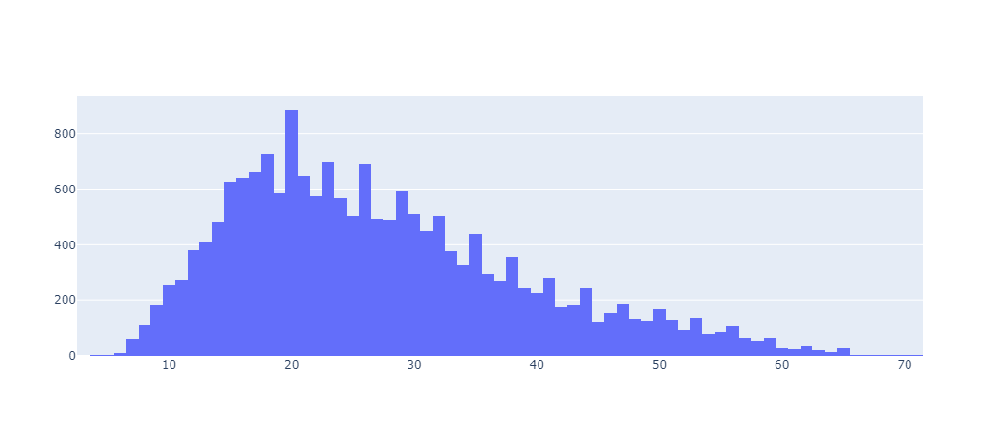

In [82]:
#Validation set is quite different from the train
#### Ignacio: In which way is the Validation set different from the train?
wifi_val.iloc[:, 0:520] = np.where(
        wifi_val.iloc[:, 0:520] <= 0,  #0 or lower signals (to ignore 100s)
        wifi_val.iloc[:, 0:520] + 105, 
        wifi_val.iloc[:, 0:520] - 100)
WAPs2_VAL = wifi_val.filter(like="WAP")
WAPsmelted2_VAL = pd.melt(WAPs2_VAL)
WAPSmelted2w0_VAL = WAPsmelted2_VAL.loc[(WAPsmelted2_VAL.iloc[:,1] != 0)]
#plt.hist(WAPSmelted2w0_VAL['value'], bins =71);
print(WAPSmelted2w0_VAL.max())
fig = go.Figure(data=[go.Histogram(x=WAPSmelted2w0_VAL['value'])])
fig.show()

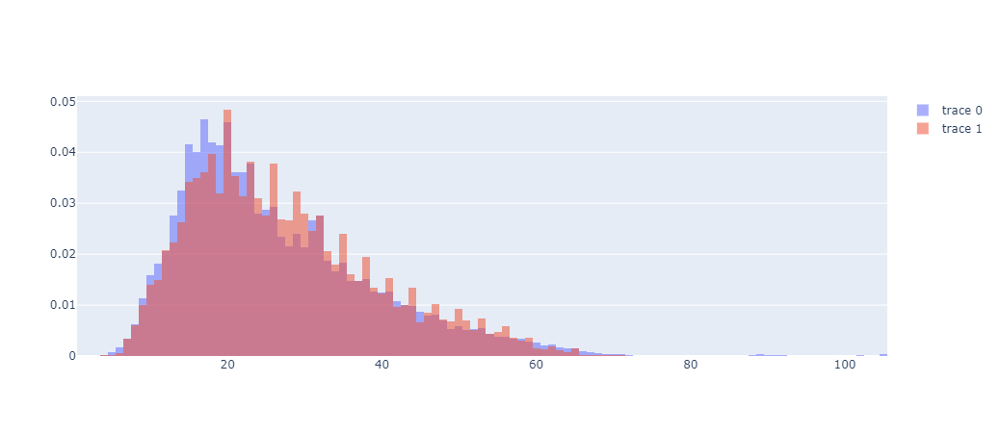

In [83]:
#### Ignacio: If you are saying that both sets are different because the distribution of their signal strengths are
#### different, you should show both histograms in the same plot. Otherwise, the scale of the x axis can be different
#### and this can lead to confussion.
#### BEWARE!!! I asked plotly to plot the DENSITY, NOT THE FREQUENCY. Therefore both denswities has the same scale on the Y axis.
fig = go.Figure()
fig.add_trace(go.Histogram(x=WAPSmelted2w0['value'],histnorm='probability'))
fig.add_trace(go.Histogram(x=WAPSmelted2w0_VAL['value'],histnorm='probability'))

# Overlay both histograms
#### Ignacio: This allow to plot both densities showing the same scale on the x axis.
fig.update_layout(barmode='overlay') 
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.55)
fig.show()

## <a class="anchor" id="LongLat"> 1.2. Longitude and Latitude </a>

In [84]:
#BEFORE CHANGE
#### Ignacio: This plot is nice but lacks of legend
wifi['set'] = 'training'
wifi_val['set'] = 'validation'
wifi_tot = pd.concat([wifi, wifi_val])
#plt.scatter(wifi["LONGITUDE"],wifi["LATITUDE"]) #TRAIN SET (blue)
#plt.scatter(wifi_val["LONGITUDE"],wifi_val["LATITUDE"]) #VALIDATION SET (orange)

fig = px.scatter_3d(wifi_tot, x='LONGITUDE', y='LATITUDE', z='FLOOR',
              color='set')
fig.show()

In [85]:
#TRAIN
#### Ignacio: What is the pourpose of doing this rotation of axis? It should be explained
angle = np.arctan(wifi["LATITUDE"][0]/wifi["LONGITUDE"][0])
angle = angle/math.pi
#### This matrix of rotatin corresponds to a rotation with a negative angle.
LONGITUDE = wifi["LONGITUDE"]*np.cos(angle) + wifi["LATITUDE"]*np.sin(angle)
LATITUDE = wifi["LATITUDE"]*np.cos(angle) - wifi["LONGITUDE"]*np.sin(angle)
#plt.scatter(LONGITUDE,LATITUDE)
wifi["LONGITUDE"] = LONGITUDE
wifi["LATITUDE"] = LATITUDE
fig = px.scatter_3d(wifi, x='LONGITUDE', y='LATITUDE', z='FLOOR',title="Rotated Training set")
fig.show()
#plt.show() #AFTER CHANGE!
#VALIDATION
VLONGITUDE = wifi_val["LONGITUDE"]*np.cos(angle) +wifi_val["LATITUDE"]*np.sin(angle)
VLATITUDE = wifi_val["LATITUDE"]*np.cos(angle) - wifi_val["LONGITUDE"]*np.sin(angle)
wifi_val["LONGITUDE"] = VLONGITUDE
wifi_val["LATITUDE"] = VLATITUDE
#plt.scatter(VLONGITUDE,VLATITUDE)
#plt.show()
fig = px.scatter_3d(wifi_val, x='LONGITUDE', y='LATITUDE', z='FLOOR',title="Rotated Validation set")
fig.show()
#ALTOGETHER
wifi_tot = pd.concat([wifi, wifi_val])
#wifi_tot.loc[wifi_tot['set']=='training',"LONGITUDE"] = wifi["LONGITUDE"]
#wifi_tot.loc[wifi_tot['set']=='training',"LATITTUDE"] = wifi["LATITUDE"]
#wifi_tot.loc[wifi_tot['set']=='validation',"LONGITUDE"] = wifi_val["LONGITUDE"]
#wifi_tot.loc[wifi_tot['set']=='validation',"LATITTUDE"] = wifi_val["LATITUDE"] 
#plt.scatter(wifi["LONGITUDE"],wifi["LATITUDE"]) #TRAIN SET (blue)
#plt.scatter(wifi_val["LONGITUDE"],wifi_val["LATITUDE"]) #VALIDATION SET (orange)
fig = px.scatter_3d(wifi_tot, x='LONGITUDE', y='LATITUDE', z='FLOOR',
              color='set',title="Overlap of rotated Training and Validation sets")
fig.show()

In [86]:
#Difference in min/max distances

#TRAIN
print(round(wifi['LONGITUDE'].max() - wifi['LONGITUDE'].min()))         #397m
print(round(wifi['LATITUDE'].max() - wifi['LATITUDE'].min()))           #106m
#VALIDATION
print(round(wifi_val['LONGITUDE'].max() - wifi_val['LONGITUDE'].min())) #403m
print(round(wifi_val['LATITUDE'].max() - wifi_val['LATITUDE'].min()))   #106m

397.0
106.0
403.0
106.0


## <a class="anchor" id="BuildingID"> 1.3. BuildingID </a>

In [87]:
#3D graph
fig = px.scatter_3d(wifi, x = 'LONGITUDE', y = 'LATITUDE', z = 'FLOOR', color = "BUILDINGID")
fig.show()
fig2 = px.scatter_3d(wifi_val, x = 'LONGITUDE', y = 'LATITUDE', z = 'FLOOR', color = "BUILDINGID")
fig2.show()

#We notice the train set has significant missing values on the last floor of the tallest building.
#This may lead to errors later on.
#### Ignacio: EXCELLENT!!! This reinforces the capital importance of data exploration. However,
#### I will not color the dots according to the building because you already know to which building 
#### belongs each as yuo know the shape of the building. I will color based on the dataset as before
#### in order to know the differences in sampling.

In [95]:
#Plot with tighter points

#TRAIN
fig = go.Figure(data=[go.Scatter3d(
   x=wifi.LATITUDE,
   y=wifi.LONGITUDE,
   z=wifi.FLOOR,
   mode='markers', marker=dict(
       size=5, colorscale='Viridis', opacity=0.5)
)])

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

#VALIDATION
fig = go.Figure(data=[go.Scatter3d(
   x=wifi_val.LATITUDE,
   y=wifi_val.LONGITUDE,
   z=wifi_val.FLOOR,
   mode='markers', marker=dict(
       size=5, colorscale='Viridis', opacity=0.5)
)])

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

## <a class="anchor" id="SpaceID"> 1.4. SpaceID </a>

In [96]:
#NOTE: SpaceID only found in Training set, because in real life you would not have this.

#wifi.SPACEID.unique() #This shows us what unique room numbers there are in an array form
print(wifi['SPACEID'].nunique()) #123 different rooms or locations, double that when inside or outside the room.

123


## <a class="anchor" id="PhoneID"> 1.5. PhoneID </a>

### Train set

In [97]:
#NOTE: Only phones carried by different users have been selected (according to paper)
#PhoneIDs no. 2,3,4,5,9,12,15,20 & 21 belong to UserID0
PhoneID_total = wifi.groupby('PHONEID') 
PhoneID_total.first() #16 different phones
PhoneID_total.get_group(1)

#Another way to do it:
ID1_SGalaxy_Ace2 = wifi[wifi['PHONEID']==1]       # 507 rows
ID3_SGalaxy_S2 = wifi[wifi['PHONEID']==3]         # 610
ID6_SGalaxy_Y = wifi[wifi['PHONEID']==6]          #1383
ID7_SGalaxy_mini2 = wifi[wifi['PHONEID']==7]      #1596
ID8_SGalaxyNexus = wifi[wifi['PHONEID']==8]       # 913
ID10_HTC_DesireHD = wifi[wifi['PHONEID']==10]     # 440
ID11_HTC_One = wifi[wifi['PHONEID']==11]          # 498
ID13_HTC_WildfireS = wifi[wifi['PHONEID']==13]    #4516
ID14_SonyXperiaP = wifi[wifi['PHONEID']==14]      #4835
ID16_SonyXperiaS = wifi[wifi['PHONEID']==16]      # 192
ID17_Unknown = wifi[wifi['PHONEID']==17]          # 841 #Chinese?
ID18_SonyXperiaNeoV = wifi[wifi['PHONEID']==18]   # 374
ID19_LG_Nexus4= wifi[wifi['PHONEID']==19]         # 980
ID22_OrangeMonteCarlo = wifi[wifi['PHONEID']==22] # 724
ID23_AsusEEE_Tablet = wifi[wifi['PHONEID']==23]   #1091 #Chinese?
ID24_BQ_Tablet = wifi[wifi['PHONEID']==24]        # 437

,Brand,Appearance
0,ID1_SGalaxy_Ace2,507
1,ID3_SGalaxy_S2,610
2,ID6_SGalaxy_Y,1383
3,ID7_SGalaxy_mini2,1596
4,ID8_SGalaxyNexus,913


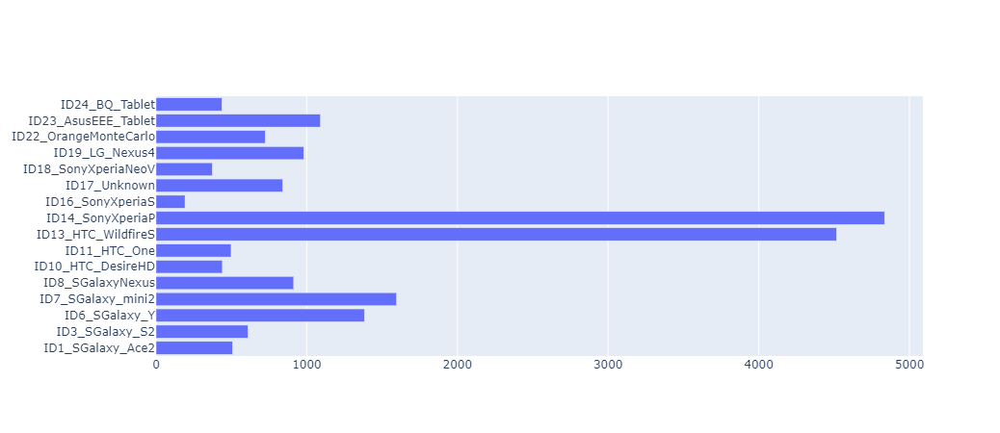

In [102]:
#Phone Distribution in Train
Phones = {'Brand': ['ID1_SGalaxy_Ace2','ID3_SGalaxy_S2','ID6_SGalaxy_Y','ID7_SGalaxy_mini2',
                  'ID8_SGalaxyNexus','ID10_HTC_DesireHD','ID11_HTC_One','ID13_HTC_WildfireS',
                  'ID14_SonyXperiaP','ID16_SonyXperiaS','ID17_Unknown','ID18_SonyXperiaNeoV',
                  'ID19_LG_Nexus4','ID22_OrangeMonteCarlo','ID23_AsusEEE_Tablet','ID24_BQ_Tablet'],
        'Appearance': [507,610,1383,1596,913,440,498,4516,4835,192,841,374,980,724,1091,437]
        }

Phones = DataFrame(Phones,columns= ['Brand', 'Appearance'])

#### Ignacio: To avoid having to rotate the axis ticks, is better to exchange the axis. In addition, as
fig = go.Figure(go.Bar(
            x=Phones['Appearance'],
            y=Phones['Brand'],
            orientation='h'))

fig.show()

#Phones.plot(figsize=(15,10))
#plt.xticks(rotation=60)

#plt.bar(Phones['Brand'],Phones['Appearance'])

variable    WAP517
value           75
dtype: object


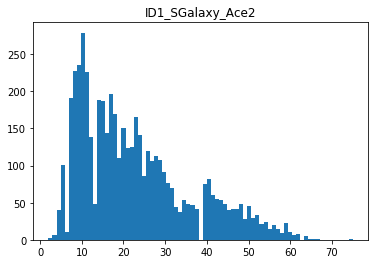

variable    WAP517
value           75
dtype: object


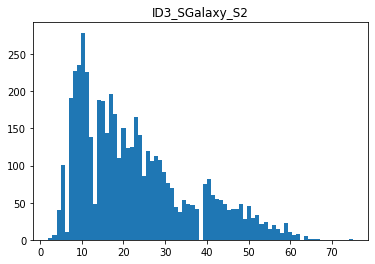

variable    WAP517
value           69
dtype: object


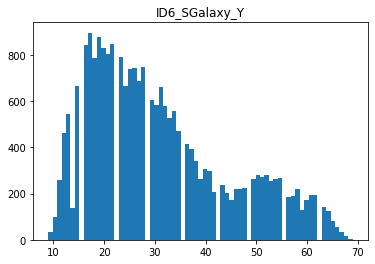

variable    WAP517
value          104
dtype: object


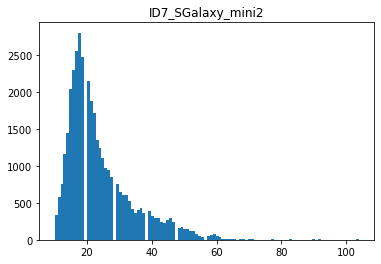

variable    WAP517
value          104
dtype: object


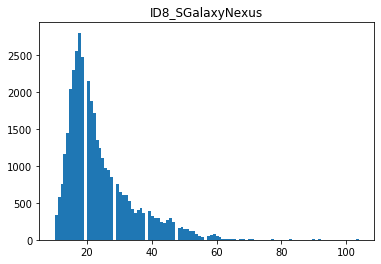

variable    WAP517
value           59
dtype: object


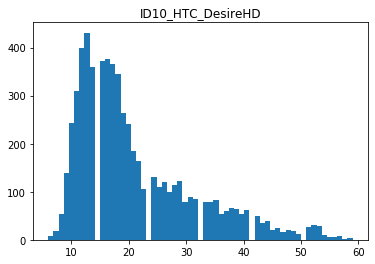

variable    WAP517
value           76
dtype: object


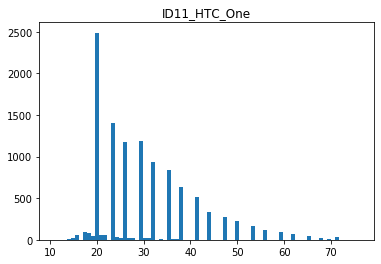

variable    WAP519
value           72
dtype: object


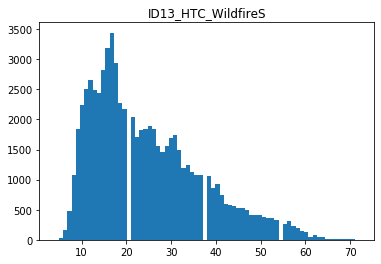

variable    WAP518
value           68
dtype: object


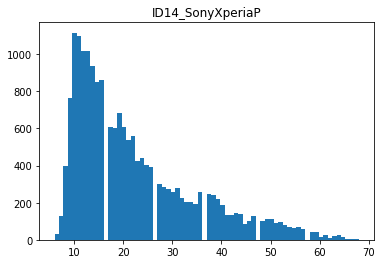

variable    WAP517
value           79
dtype: object


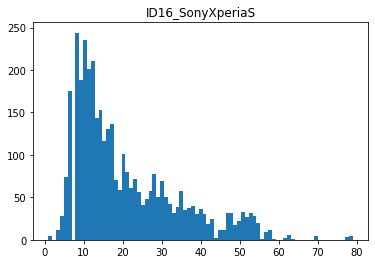

variable    WAP517
value           60
dtype: object


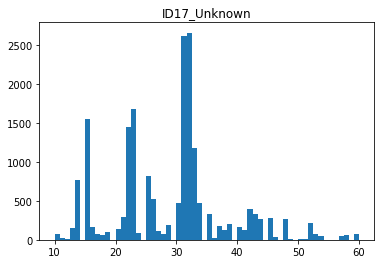

variable    WAP468
value           60
dtype: object


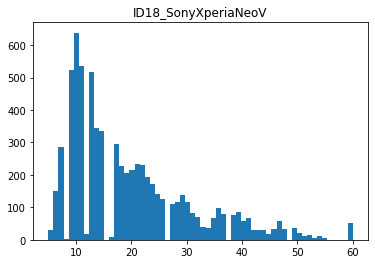

variable    WAP517
value          105
dtype: object


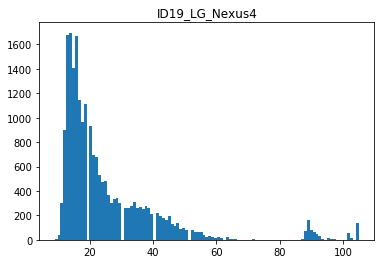

variable    WAP517
value           68
dtype: object


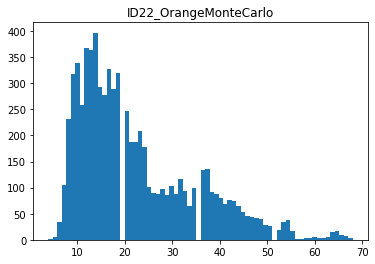

variable    WAP518
value           68
dtype: object


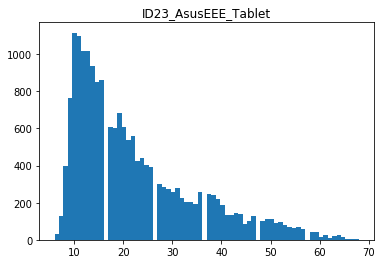

variable    WAP518
value           67
dtype: object


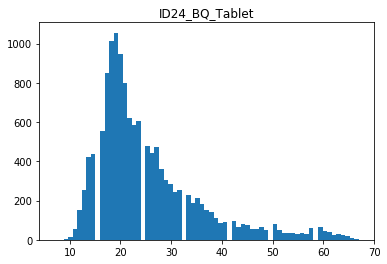

In [103]:
#ID1_SGalaxy_Ace2
WAPID1 = ID1_SGalaxy_Ace2.filter(like="WAP")
WAPID1smelted = pd.melt(WAPID1)
WAPSID1meltedw0 = WAPID1smelted.loc[(WAPID1smelted.iloc[:,1] != 0)]
plt.hist(WAPSID1meltedw0['value'], bins =75);
plt.title('ID1_SGalaxy_Ace2')
print(WAPSID1meltedw0.max())
plt.show()
#ID3_SGalaxy_S2
WAPID3 = ID3_SGalaxy_S2.filter(like="WAP")
WAPID3smelted = pd.melt(WAPID1)
WAPSID3meltedw0 = WAPID3smelted.loc[(WAPID3smelted.iloc[:,1] != 0)]
plt.hist(WAPSID3meltedw0['value'], bins =75);
print(WAPSID3meltedw0.max())
plt.title('ID3_SGalaxy_S2')
plt.show()
#ID6_SGalaxy_Y
WAPID6 = ID6_SGalaxy_Y.filter(like="WAP")
WAPID6smelted = pd.melt(WAPID6)
WAPSID6meltedw0 = WAPID6smelted.loc[(WAPID6smelted.iloc[:,1] != 0)]
plt.hist(WAPSID6meltedw0['value'], bins =69);
plt.title('ID6_SGalaxy_Y')
print(WAPSID6meltedw0.max())
plt.show()
#ID7_SGalaxy_mini2
WAPID7 = ID7_SGalaxy_mini2.filter(like="WAP")
WAPID7smelted = pd.melt(WAPID7)
WAPSID7meltedw0 = WAPID7smelted.loc[(WAPID7smelted.iloc[:,1] != 0)]
plt.hist(WAPSID7meltedw0['value'], bins =104);
plt.title('ID7_SGalaxy_mini2')
print(WAPSID7meltedw0.max())
plt.show()
#ID8_SGalaxyNexus
WAPID8 = ID8_SGalaxyNexus.filter(like="WAP")
WAPID8smelted = pd.melt(WAPID7)
WAPSID8meltedw0 = WAPID8smelted.loc[(WAPID8smelted.iloc[:,1] != 0)]
plt.hist(WAPSID8meltedw0['value'], bins =104);
plt.title('ID8_SGalaxyNexus')
print(WAPSID8meltedw0.max())
plt.show()
#ID10_HTC_DesireHD
WAPID10 = ID10_HTC_DesireHD.filter(like="WAP")
WAPID10smelted = pd.melt(WAPID10)
WAPSID10meltedw0 = WAPID10smelted.loc[(WAPID10smelted.iloc[:,1] != 0)]
plt.hist(WAPSID10meltedw0['value'], bins =59);
plt.title('ID10_HTC_DesireHD')
print(WAPSID10meltedw0.max())
plt.show()
#ID11_HTC_One
WAPID11 = ID11_HTC_One.filter(like="WAP")
WAPID11smelted = pd.melt(WAPID11)
WAPSID11meltedw0 = WAPID11smelted.loc[(WAPID11smelted.iloc[:,1] != 0)]
plt.hist(WAPSID11meltedw0['value'], bins =76);
plt.title('ID11_HTC_One')
print(WAPSID11meltedw0.max())
plt.show()
#ID13_HTC_WildfireS
WAPID13 = ID13_HTC_WildfireS.filter(like="WAP")
WAPID13smelted = pd.melt(WAPID13)
WAPSID13meltedw0 = WAPID13smelted.loc[(WAPID13smelted.iloc[:,1] != 0)]
plt.hist(WAPSID13meltedw0['value'], bins =72);
plt.title('ID13_HTC_WildfireS')
print(WAPSID13meltedw0.max())
plt.show()
#ID14_SonyXperiaP
WAPID14 = ID23_AsusEEE_Tablet.filter(like="WAP")
WAPID14smelted = pd.melt(WAPID14)
WAPSID14meltedw0 = WAPID14smelted.loc[(WAPID14smelted.iloc[:,1] != 0)]
plt.hist(WAPSID14meltedw0['value'], bins =68);
plt.title('ID14_SonyXperiaP')
print(WAPSID14meltedw0.max())
plt.show()
#ID16_SonyXperiaS
WAPID16 = ID16_SonyXperiaS.filter(like="WAP")
WAPID16smelted = pd.melt(WAPID16)
WAPSID16meltedw0 = WAPID16smelted.loc[(WAPID16smelted.iloc[:,1] != 0)]
plt.hist(WAPSID16meltedw0['value'], bins =79);
plt.title('ID16_SonyXperiaS')
print(WAPSID16meltedw0.max())
plt.show()
#ID17_Unknown
WAPID17 = ID17_Unknown.filter(like="WAP")
WAPID17smelted = pd.melt(WAPID17)
WAPSID17meltedw0 = WAPID17smelted.loc[(WAPID17smelted.iloc[:,1] != 0)]
plt.hist(WAPSID17meltedw0['value'], bins =60);
plt.title('ID17_Unknown')
print(WAPSID17meltedw0.max())
plt.show()
#ID18_SonyXperiaNeoV
WAPID18 = ID18_SonyXperiaNeoV.filter(like="WAP")
WAPID18smelted = pd.melt(WAPID18)
WAPSID18meltedw0 = WAPID18smelted.loc[(WAPID18smelted.iloc[:,1] != 0)]
plt.hist(WAPSID18meltedw0['value'], bins =60);
plt.title('ID18_SonyXperiaNeoV')
print(WAPSID18meltedw0.max())
plt.show()
#ID19_LG_Nexus4
WAPID19 = ID19_LG_Nexus4.filter(like="WAP")
WAPID19smelted = pd.melt(WAPID19)
WAPSID19meltedw0 = WAPID19smelted.loc[(WAPID19smelted.iloc[:,1] != 0)]
plt.hist(WAPSID19meltedw0['value'], bins =105);
plt.title('ID19_LG_Nexus4')
print(WAPSID19meltedw0.max())
plt.show()
#ID22_OrangeMonteCarlo
WAPID22 = ID22_OrangeMonteCarlo.filter(like="WAP")
WAPID22smelted = pd.melt(WAPID22)
WAPSID22meltedw0 = WAPID22smelted.loc[(WAPID22smelted.iloc[:,1] != 0)]
plt.hist(WAPSID22meltedw0['value'], bins =68);
plt.title('ID22_OrangeMonteCarlo')
print(WAPSID22meltedw0.max())
plt.show()
#ID23_AsusEEE_Tablet
WAPID23 = ID23_AsusEEE_Tablet.filter(like="WAP")
WAPID23smelted = pd.melt(WAPID23)
WAPSID23meltedw0 = WAPID23smelted.loc[(WAPID23smelted.iloc[:,1] != 0)]
plt.hist(WAPSID23meltedw0['value'], bins =68);
plt.title('ID23_AsusEEE_Tablet')
print(WAPSID23meltedw0.max())
plt.show()
#ID24_BQ_Tablet
WAPID24 = ID24_BQ_Tablet.filter(like="WAP")
WAPID24smelted = pd.melt(WAPID24)
WAPSID24meltedw0 = WAPID24smelted.loc[(WAPID24smelted.iloc[:,1] != 0)]
plt.hist(WAPSID24meltedw0['value'], bins =67);
plt.title('ID24_BQ_Tablet')
print(WAPSID24meltedw0.max())
plt.show()

### INSIGHTS EXTRACTED (Train set):
**Problematic phones:**

**Samsung Galaxy Mini2 (ID7)**, **Samsung Galaxy Nexus (ID8)** and **LG Nexus 4 (ID19)** have generally weaker signals and a few unlikely perfect signals. <br>
**HTC One (ID11)** has many gaps (seems to only be able to detect certain strength numbers). <br>
**The Unknown device (ID17)** shows a crazy performance.

All these phones comprise (IDs: 7,8,11,17,19) **around 24%** of the data.

### Validation set

In [104]:
#Phone 13 and 14 are the only ones that are both in train and validation

PhoneID_total_VAL = wifi_val.groupby('PHONEID') 
PhoneID_total_VAL.first() #11 different phones in validation set

ID0_CelkonA27 = wifi_val[wifi_val['PHONEID']==0]           #120
ID2_SGalaxy_Ace2 = wifi_val[wifi_val['PHONEID']==2]        # 52
ID4_SGalaxy_S3 = wifi_val[wifi_val['PHONEID']==4]          # 69
ID5_SGalaxy_S4 = wifi_val[wifi_val['PHONEID']==5]          # 17
ID9_SGalaxyNexus = wifi_val[wifi_val['PHONEID']==9]        # 77
ID12_HTC_One = wifi_val[wifi_val['PHONEID']==12]           # 70
ID13_HTC_WildfireS_VAL = wifi_val[wifi_val['PHONEID']==13] #369
ID14_SonyXperiaP_VAL = wifi_val[wifi_val['PHONEID']==14]   # 28
ID15_SonyXperiaP_VAL = wifi_val[wifi_val['PHONEID']==15]   # 36
ID20_LG_Nexus4= wifi_val[wifi_val['PHONEID']==20]          #213
ID21_LG_NexusS= wifi_val[wifi_val['PHONEID']==21]          # 60

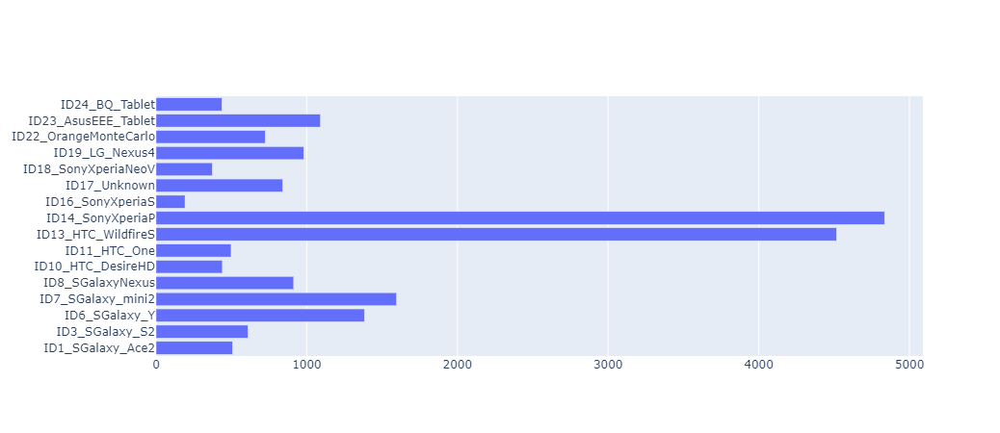

In [106]:
#Phone Distribution in Validation
Phones2 = {'Brand': ['ID0_CelkonA27','ID2_SGalaxy_Ace2','ID4_SGalaxy_S3',
                     'ID5_SGalaxy_S4','ID9_SGalaxyNexus','ID12_HTC_One',
                     'ID13_HTC_WildfireS_VAL','ID14_SonyXperiaP_VAL',
                     'ID15_SonyXperiaP_VAL','ID20_LG_Nexus4','ID21_LG_NexusS'],
        'Appearance': [120,52,69,17,77,70,369,28,36,213,60]
        }

Phones2 = DataFrame(Phones2,columns= ['Brand', 'Appearance'])

#Phones2.plot(figsize=(15,10))
#plt.xticks(rotation=60)
#plt.bar(Phones2['Brand'],Phones2['Appearance'])

#### Ignacio: To avoid having to rotate the axis ticks, is better to exchange the axis. In addition, as
fig = go.Figure(go.Bar(
            x=Phones['Appearance'],
            y=Phones['Brand'],
            orientation='h'))

fig.show()

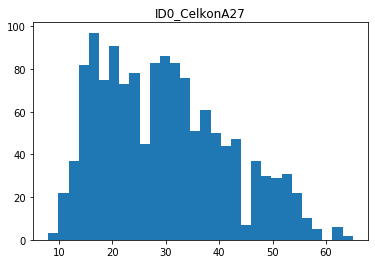

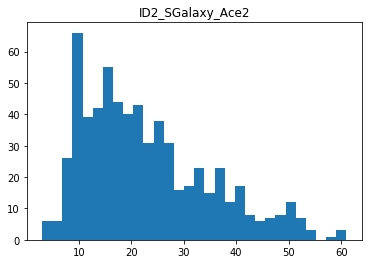

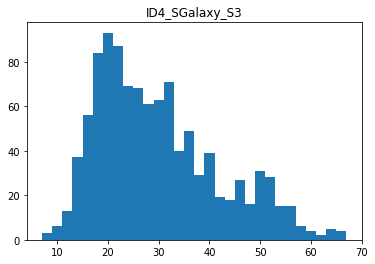

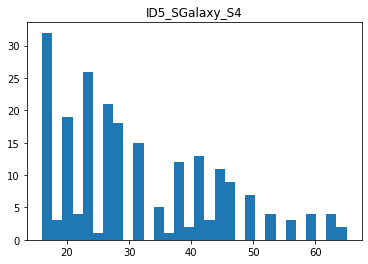

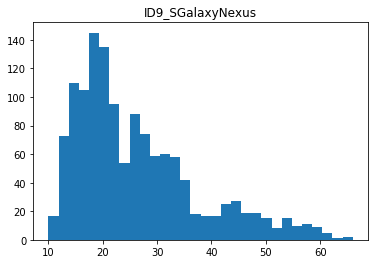

...

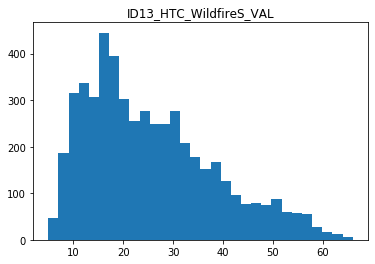

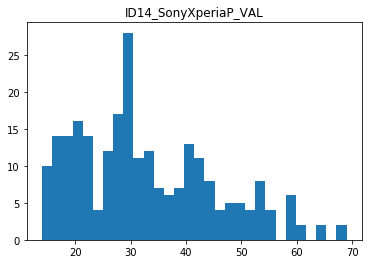

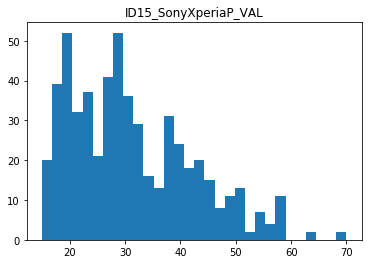

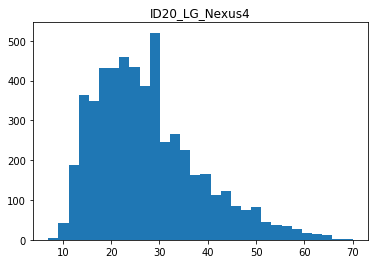

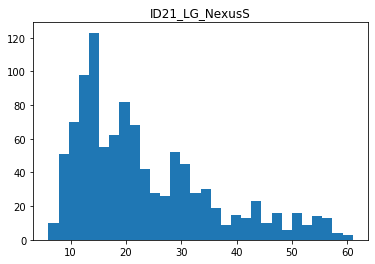

In [107]:
#ID0_CelkonA27
WAPID0 = ID0_CelkonA27.filter(like="WAP")
WAPID0smelted = pd.melt(WAPID0)
WAPSID0meltedw0 = WAPID0smelted.loc[(WAPID0smelted.iloc[:,1] != 0)]
plt.hist(WAPSID0meltedw0['value'], bins =30);
plt.title('ID0_CelkonA27')
plt.show()
#ID2_SGalaxy_Ace2
WAPID2 = ID2_SGalaxy_Ace2.filter(like="WAP")
WAPID2smelted = pd.melt(WAPID2)
WAPSID2meltedw0 = WAPID2smelted.loc[(WAPID2smelted.iloc[:,1] != 0)]
plt.hist(WAPSID2meltedw0['value'], bins =30);
plt.title('ID2_SGalaxy_Ace2')
plt.show()
#ID4_SGalaxy_S3
WAPID4 = ID4_SGalaxy_S3.filter(like="WAP")
WAPID4smelted = pd.melt(WAPID4)
WAPSID4meltedw0 = WAPID4smelted.loc[(WAPID4smelted.iloc[:,1] != 0)]
plt.hist(WAPSID4meltedw0['value'], bins =30);
plt.title('ID4_SGalaxy_S3')
plt.show()
#ID5_SGalaxy_S4
WAPID5 = ID5_SGalaxy_S4.filter(like="WAP")
WAPID5smelted = pd.melt(WAPID5)
WAPSID5meltedw0 = WAPID5smelted.loc[(WAPID5smelted.iloc[:,1] != 0)]
plt.hist(WAPSID5meltedw0['value'], bins =30);
plt.title('ID5_SGalaxy_S4')
plt.show()
#ID9_SGalaxyNexus
WAPID9 = ID9_SGalaxyNexus.filter(like="WAP")
WAPID9smelted = pd.melt(WAPID9)
WAPSID9meltedw0 = WAPID9smelted.loc[(WAPID9smelted.iloc[:,1] != 0)]
plt.hist(WAPSID9meltedw0['value'], bins =30);
plt.title('ID9_SGalaxyNexus')
plt.show()
#ID12_HTC_One
WAPID12 = ID12_HTC_One.filter(like="WAP")
WAPID12smelted = pd.melt(WAPID12)
WAPSID12meltedw0 = WAPID12smelted.loc[(WAPID12smelted.iloc[:,1] != 0)]
plt.hist(WAPSID12meltedw0['value'], bins =30);
plt.title('ID12_HTC_One')
plt.show()
#ID13_HTC_WildfireS_VAL
WAPID13 = ID13_HTC_WildfireS_VAL.filter(like="WAP")
WAPID13smelted = pd.melt(WAPID13)
WAPSID13meltedw0 = WAPID13smelted.loc[(WAPID13smelted.iloc[:,1] != 0)]
plt.hist(WAPSID13meltedw0['value'], bins =30);
plt.title('ID13_HTC_WildfireS_VAL')
plt.show()
#ID14_SonyXperiaP_VAL
WAPID14 = ID14_SonyXperiaP_VAL.filter(like="WAP")
WAPID14smelted = pd.melt(WAPID14)
WAPSID14meltedw0 = WAPID14smelted.loc[(WAPID14smelted.iloc[:,1] != 0)]
plt.hist(WAPSID14meltedw0['value'], bins =30);
plt.title('ID14_SonyXperiaP_VAL')
plt.show()
#ID15_SonyXperiaP_VAL
WAPID15 = ID15_SonyXperiaP_VAL.filter(like="WAP")
WAPID15smelted = pd.melt(WAPID15)
WAPSID15meltedw0 = WAPID15smelted.loc[(WAPID15smelted.iloc[:,1] != 0)]
plt.hist(WAPSID15meltedw0['value'], bins =30);
plt.title('ID15_SonyXperiaP_VAL')
plt.show()
#ID20_LG_Nexus4
WAPID20 = ID20_LG_Nexus4.filter(like="WAP")
WAPID20smelted = pd.melt(WAPID20)
WAPSID20meltedw0 = WAPID20smelted.loc[(WAPID20smelted.iloc[:,1] != 0)]
plt.hist(WAPSID20meltedw0['value'], bins =30);
plt.title('ID20_LG_Nexus4')
plt.show()
#ID21_LG_NexusS
WAPID21 = ID21_LG_NexusS.filter(like="WAP")
WAPID21smelted = pd.melt(WAPID21)
WAPSID21meltedw0 = WAPID21smelted.loc[(WAPID21smelted.iloc[:,1] != 0)]
plt.hist(WAPSID21meltedw0['value'], bins =30);
plt.title('ID21_LG_NexusS')
plt.show()

### INSIGHTS EXTRACTED (Validation set):
**Problematic phones:**

**SGalaxy_S4 (ID5)** and **HTC_One (ID12)** present regular gaps (seem to only be able to detect certain strength numbers). <br>
**SonyXperiaP_VAL (ID14)** shows a weird performance, with seemingly random peaks and **LG_NexusS (ID21)** is similar, but less pronunciated.

All these phones comprise (IDs: 5,12,14,21) **around 16%** of the data.

## <a class="anchor" id="Timestamp"> 1.6. Timestamp </a>

In [108]:
# TRAIN SET
print(wifi['TIMESTAMP'].nunique()) #9965 out of 19937 different trials, so half the dataset is repeated
# VALIDATION SET
print(wifi_val['TIMESTAMP'].nunique()) #1052 out of 1111, so data is mostly unique (more real)

9965
1052
